In [116]:
import xarray as xr
import gcsfs
from glob import glob
from tqdm import tqdm
from dask.diagnostics import ProgressBar, Profiler
import dask
import os
import shutil
import numpy as np
from dask.distributed import Client, LocalCluster
from matplotlib import pyplot as plt
%matplotlib inline
from IPython.display import clear_output


In [117]:
ddir = '/swot/SUM02/as4479/POP_nn_predictions/'

In [119]:
ds = xr.open_mfdataset(ddir+'POP_global_1200batch_3layer402010nn*', chunks={'time': 1})
ds

<xarray.Dataset>
Dimensions:   (nlat: 2400, nlon: 3600, time: 365)
Coordinates:
  * nlon      (nlon) int64 0 1 2 3 4 5 6 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat      (nlat) int64 0 1 2 3 4 5 6 ... 2393 2394 2395 2396 2397 2398 2399
  * time      (time) datetime64[ns] 1951-01-01 1951-01-02 ... 1951-12-31
Data variables:
    mask_tot  (time, nlat, nlon) bool dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    mask_lat  (time, nlat, nlon) bool dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    mask_geo  (time, nlat, nlon) bool dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    u_t_um    (time, nlat, nlon) float32 dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    v_t_um    (time, nlat, nlon) float32 dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    u_n_um    (time, nlat, nlon) float32 dask.array<shape=(365, 2400, 3600), chunksize=(1, 2400, 3600)>
    v_n_um    (time, nlat, nlon) float32 dask.array<shap

In [120]:
plt.rcParams.update({'font.size': 14
    , 'legend.markerscale': 1., 'axes.titlesize': 18, 'axes.labelsize' : 13,
      'legend.fontsize' : 13,'legend.handlelength': 3})

plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=10)

lw=2
aph=.2

plt.rcParams['figure.figsize'] = (12.,7.5)


In [121]:
figdir = 'Figs_NN/'

In [193]:
ds_snap0 = ds.isel(time=176).load()
ds_snap_all=ds.isel(nlat=slice(200,1000))

In [220]:
#ds_snap = ds_snap_all.mean(dim='time').load()
ds_snap = ds_snap_all.isel(time=176).load()
ds_snap


<xarray.Dataset>
Dimensions:   (nlat: 800, nlon: 3600)
Coordinates:
  * nlon      (nlon) int64 0 1 2 3 4 5 6 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat      (nlat) int64 200 201 202 203 204 205 ... 994 995 996 997 998 999
    time      datetime64[ns] 1951-06-26
Data variables:
    mask_tot  (nlat, nlon) bool False True True True ... True True True False
    mask_lat  (nlat, nlon) bool True True True True True ... True True True True
    mask_geo  (nlat, nlon) bool False True True True ... True True True False
    u_t_um    (nlat, nlon) float32 nan -4.8179793 -4.8161182 ... -2.3894317 nan
    v_t_um    (nlat, nlon) float32 nan -7.90137 -7.9648786 ... 1.1446985 nan
    u_n_um    (nlat, nlon) float32 nan -2.469885 -2.5689719 ... -5.70566 nan
    v_n_um    (nlat, nlon) float32 nan -6.8165493 -6.801092 ... -1.7648776 nan
    u_g_um    (nlat, nlon) float64 nan -3.837 -3.929 -4.01 ... -2.775 -3.113 nan
    v_g_um    (nlat, nlon) float64 nan -2.755 -2.855 -2.9 ... 4.547 4.186 nan
    u_e_

In [221]:
ds_rossby0 = xr.open_mfdataset(ddir+'POP_RossbyNumber*', chunks={'time': 1}).isel(nlat=slice(200,1000))
ds_rossby0

<xarray.Dataset>
Dimensions:  (nlat: 800, nlon: 3600, time: 365)
Coordinates:
  * nlon     (nlon) int64 0 1 2 3 4 5 6 7 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat     (nlat) int64 200 201 202 203 204 205 ... 994 995 996 997 998 999
  * time     (time) datetime64[ns] 1951-01-01 1951-01-02 ... 1951-12-31
Data variables:
    zeta     (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    f        (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    Ro       (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    DXT      (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    DYT      (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    XU       (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3600), chunksize=(1, 800, 3600)>
    YU       (time, nlat, nlon) float64 dask.array<shape=(365, 800, 3

In [222]:
#ds_rossby = ds_rossby0.mean(dim='time').load()
ds_rossby = ds_rossby0.isel(time=176).load()
ds_rossby

<xarray.Dataset>
Dimensions:  (nlat: 800, nlon: 3600)
Coordinates:
  * nlon     (nlon) int64 0 1 2 3 4 5 6 7 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat     (nlat) int64 200 201 202 203 204 205 ... 994 995 996 997 998 999
    time     datetime64[ns] 1951-06-26
Data variables:
    zeta     (nlat, nlon) float64 nan -4.94e-07 -5.983e-07 ... -3.809e-07 nan
    f        (nlat, nlon) float64 -0.000137 -0.000137 ... -4.483e-05 -4.483e-05
    Ro       (nlat, nlon) float64 nan 0.003605 0.004366 ... 0.008496 nan
    DXT      (nlat, nlon) float64 3.799e+05 3.799e+05 ... 1.058e+06 1.058e+06
    DYT      (nlat, nlon) float64 4.699e+05 4.699e+05 ... 1.058e+06 1.058e+06
    XU       (nlat, nlon) float64 -109.9 -109.8 -109.7 ... -110.2 -110.1 -110.0
    YU       (nlat, nlon) float64 -70.0 -70.0 -70.0 -70.0 ... -17.9 -17.9 -17.9
    U        (nlat, nlon) float32 -4.7746773 -4.8179793 ... -2.3894317 -2.844381
    V        (nlat, nlon) float32 -7.7994356 -7.90137 ... 1.1446985 -0.23332708

In [223]:
def mean_abs_error(a,b):
    mae=(np.abs(a-b)).mean()
    return mae
def bias(a,b):
    bias = a.mean() -b.mean()
    return bias
def mean_square_error(a,b):
    mse = ((a-b)**2).mean()
    return mse
def root_mean_square_error(a,b):
    rmse = np.sqrt(((a-b)**2).mean())
    return rmse
def mean_abs_error_2(u1,v1,u2,v2):
    mae = (np.abs(u2-u1) + np.abs(v2-v1)).mean()
    return mae

def mean_square_error_2(u1,v1,u2,v2):
    mse = ((u2-u1)**2+(v2-v1)**2).mean()
    return mse
def root_mean_square_error_2(u1,v1,u2,v2):
    rmse = np.sqrt(((u2-u1)**2+(v2-v1)**2).mean())
    return rmse

def angle_diff(u1,v1,u2,v2):
    theta =(np.arccos((u1*u2 + v1*v2)/(np.sqrt(u1**2+v1**2)*np.sqrt(u2**2+v2**2)))).mean()
    return theta


In [224]:
Err = {}
Err['MAE_tot_n'] = mean_abs_error_2(ds_snap.u_n,ds_snap.v_n, ds_snap.u_t, ds_snap.v_t)
Err['MAE_tot_ge'] = mean_abs_error_2(ds_snap.u_ge,ds_snap.v_ge, ds_snap.u_t, ds_snap.v_t)
Err['MAE_tot_g'] = mean_abs_error_2(ds_snap.u_g,ds_snap.v_g, ds_snap.u_t, ds_snap.v_t)
Err['MSE_tot_n'] = mean_square_error_2(ds_snap.u_n,ds_snap.v_n, ds_snap.u_t, ds_snap.v_t)
Err['MSE_tot_ge'] = mean_square_error_2(ds_snap.u_ge,ds_snap.v_ge, ds_snap.u_t, ds_snap.v_t)
Err['MSE_tot_g'] = mean_square_error_2(ds_snap.u_g,ds_snap.v_g, ds_snap.u_t, ds_snap.v_t)

Err['angle_n'] = angle_diff(ds_snap.u_n,ds_snap.v_n, ds_snap.u_t, ds_snap.v_t)
Err['angle_ge'] = angle_diff(ds_snap.u_ge,ds_snap.v_ge, ds_snap.u_t, ds_snap.v_t)
Err['angle_g'] = angle_diff(ds_snap.u_g,ds_snap.v_g, ds_snap.u_t, ds_snap.v_t)

Err['MAE_u_n'] = mean_abs_error(ds_snap.u_n, ds_snap.u_t)
Err['MAE_v_n'] = mean_abs_error(ds_snap.v_n, ds_snap.v_t)
Err['MAE_u_ge'] = mean_abs_error(ds_snap.u_ge, ds_snap.u_t)
Err['MAE_v_ge'] = mean_abs_error(ds_snap.v_ge, ds_snap.v_t)
Err['MAE_u_g'] = mean_abs_error(ds_snap.u_g, ds_snap.u_t)
Err['MAE_v_g'] = mean_abs_error(ds_snap.v_g, ds_snap.v_t)

Err['MSE_u_n'] = mean_square_error(ds_snap.u_n, ds_snap.u_t)
Err['MSE_v_n'] = mean_square_error(ds_snap.v_n, ds_snap.v_t)
Err['MSE_u_ge'] = mean_square_error(ds_snap.u_ge, ds_snap.u_t)
Err['MSE_v_ge'] = mean_square_error(ds_snap.v_ge, ds_snap.v_t)
Err['MSE_u_g'] = mean_square_error(ds_snap.u_g, ds_snap.u_t)
Err['MSE_v_g'] = mean_square_error(ds_snap.v_g, ds_snap.v_t)

Err['bias_u_n'] = bias(ds_snap.u_n, ds_snap.u_t)
Err['bias_v_n'] = bias(ds_snap.v_n, ds_snap.v_t)
Err['bias_u_ge'] = bias(ds_snap.u_ge, ds_snap.u_t)
Err['bias_v_ge'] = bias(ds_snap.v_ge, ds_snap.v_t)
Err['bias_u_g'] = bias(ds_snap.u_g, ds_snap.u_t)
Err['bias_v_g'] = bias(ds_snap.v_g, ds_snap.v_t)


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/core/computation.py:561: RuntimeWarning: invalid value encountered in arccos
  result_data = func(*input_data)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/core/computation.py:561: RuntimeWarning: invalid value encountered in arccos
  result_data = func(*input_data)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/core/computation.py:561: RuntimeWarning: invalid value encountered in arccos
  result_data = func(*input_data)


In [126]:
print(Err['MAE_u_n'].values)

2.7598844


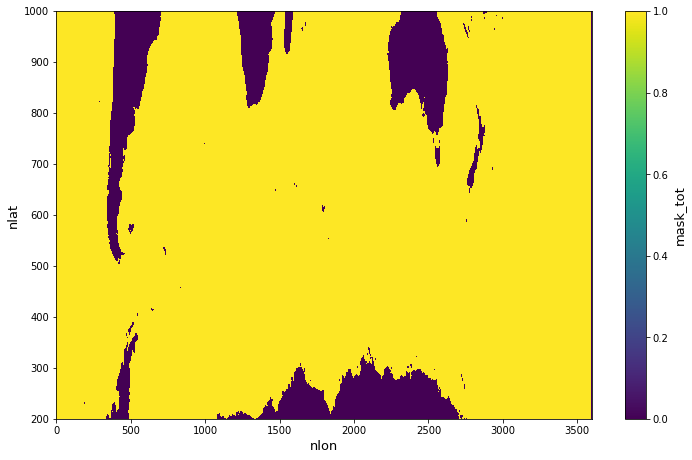

In [208]:
ds_snap.mask_tot.plot()

In [225]:
XU = ds_snap.XU.values
YU = ds_snap.YU.values

In [226]:
x,y = np.meshgrid(np.roll(XU[200], 700),YU[:,200])

In [227]:
vels = {}
vels['u_t'] = np.roll(ds_snap.u_t.values, 700, axis=1)
vels['v_t'] = np.roll(ds_snap.v_t.values, 700, axis=1)
vels['u_n'] = np.roll(ds_snap.u_n.values, 700, axis=1)
vels['v_n'] = np.roll(ds_snap.v_n.values, 700, axis=1)
#vels['u_ge'] = np.roll(ds_snap.u_ge.values, 700, axis=1)
#vels['v_ge'] = np.roll(ds_snap.v_ge.values, 700, axis=1)
vels['u_g'] = np.roll(ds_snap.u_g.values, 700, axis=1)
vels['v_g'] = np.roll(ds_snap.v_g.values, 700, axis=1)
vels['u_ge'] = np.roll(ds_snap.u_g.values, 700, axis=1)+np.sqrt(10)*np.roll(ds_snap.u_e.values, 700, axis=1)
vels['v_ge'] = np.roll(ds_snap.v_g.values, 700, axis=1)+np.sqrt(10)*np.roll(ds_snap.u_e.values, 700, axis=1)

vels['ae_u_n'] = np.abs(vels['u_n'] - vels['u_t'])
vels['ae_v_n'] = np.abs(vels['v_n'] - vels['v_t'])

vels['ae_u_ge'] = np.abs(vels['u_ge'] - vels['u_t'])
vels['ae_v_ge'] = np.abs(vels['v_ge'] - vels['v_t'])

vels['ae_u_g'] = np.abs(vels['u_g'] - vels['u_t'])
vels['ae_v_g'] = np.abs(vels['v_g'] - vels['v_t'])



In [228]:
vels['se_n'] = (vels['u_n'] - vels['u_t'])**2 + (vels['v_n'] - vels['v_t'])**2

vels['se_ge'] = (vels['u_ge'] - vels['u_t'])**2 + (vels['v_ge'] - vels['v_t'])**2

vels['se_g'] = (vels['u_g'] - vels['u_t'])**2 + (vels['v_g'] - vels['v_t'])**2



In [229]:
vels['abs_Ro'] = np.roll(np.abs(ds_rossby.Ro.values), 700, axis=1)
vels['Ro'] = np.roll(ds_rossby.Ro.values, 700, axis=1)


In [230]:
vels['mask'] = np.roll(ds_snap0.isel(nlat=slice(200,1000)).mask_tot.values, 700, axis=1)
vels['mask']

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

In [232]:
def masked_vel(u, mask):
    u_masked = np.ma.masked_array(u, ~mask)
    return u_masked

In [233]:
varlist = [s for s in vels.keys() if not s.startswith('mask')]
for var in varlist:
    print(var)

u_t
v_t
u_n
v_n
u_g
v_g
u_ge
v_ge
ae_u_n
ae_v_n
ae_u_ge
ae_v_ge
ae_u_g
ae_v_g
se_n
se_ge
se_g
abs_Ro
Ro


In [234]:
varlist = [s for s in vels.keys() if not s.startswith('mask')]
suffix2 = '_m'
    
for var in varlist:
    vels[var+suffix2] = masked_vel(vels[var],vels['mask'])

In [235]:
vels.keys()

dict_keys(['u_t', 'v_t', 'u_n', 'v_n', 'u_g', 'v_g', 'u_ge', 'v_ge', 'ae_u_n', 'ae_v_n', 'ae_u_ge', 'ae_v_ge', 'ae_u_g', 'ae_v_g', 'se_n', 'se_ge', 'se_g', 'abs_Ro', 'Ro', 'mask', 'u_t_m', 'v_t_m', 'u_n_m', 'v_n_m', 'u_g_m', 'v_g_m', 'u_ge_m', 'v_ge_m', 'ae_u_n_m', 'ae_v_n_m', 'ae_u_ge_m', 'ae_v_ge_m', 'ae_u_g_m', 'ae_v_g_m', 'se_n_m', 'se_ge_m', 'se_g_m', 'abs_Ro_m', 'Ro_m'])

In [264]:
vels['KE'] = 0.5*(vels['u_t_m']**2 + vels['v_t_m']**2)
vels['re_n'] = vels['se_n_m']/(vels['KE'])
vels['re_ge'] = vels['se_ge_m']/(vels['KE'])
vels['re_g'] = vels['se_g_m']/(vels['KE'])

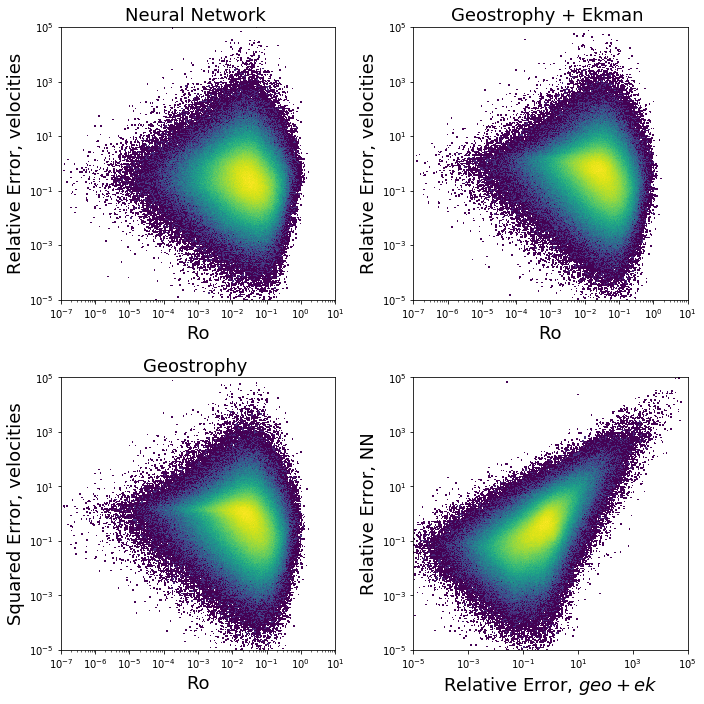

In [272]:
corrs= {}
corrs['re_n'] = ((vels['re_n'])).compressed()
corrs['re_ge'] = ((vels['re_ge'])).compressed()
corrs['re_g'] = ((vels['re_g'])).compressed()
#corrs['se_g'] = vels['se_g_m'].ravel()
#corrs['se_ge'] = vels['se_ge_m'].ravel()
corrs['Ro'] = ((vels['abs_Ro_m'])).compressed()

x_space = np.logspace(np.log10(10**-7), np.log10(10), 500)
#print('x_space:', x_space)

y_space = np.logspace(np.log10(10**-5), np.log10(10**5), 500)
#print('y_space:', y_space)

plt.figure(figsize=(10,10))
plt.subplot(221)
plt.hist2d(corrs['Ro'],corrs['re_n'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Relative Error, velocities', fontsize=18)
plt.title('Neural Network ', fontsize=18)



plt.subplot(222)
plt.hist2d(corrs['Ro'],corrs['re_ge'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Relative Error, velocities', fontsize=18)
plt.title('Geostrophy + Ekman ', fontsize=18)



plt.subplot(223)
plt.hist2d(corrs['Ro'],corrs['re_g'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Squared Error, velocities', fontsize=18)
plt.title('Geostrophy ', fontsize=18)


plt.subplot(224)
plt.hist2d(corrs['re_ge'],corrs['re_n'], bins=(y_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Relative Error, $geo+ek$', fontsize=18)
plt.ylabel('Relative Error, NN', fontsize=18)


plt.tight_layout()

#plt.xlim([-0.02,1.5])

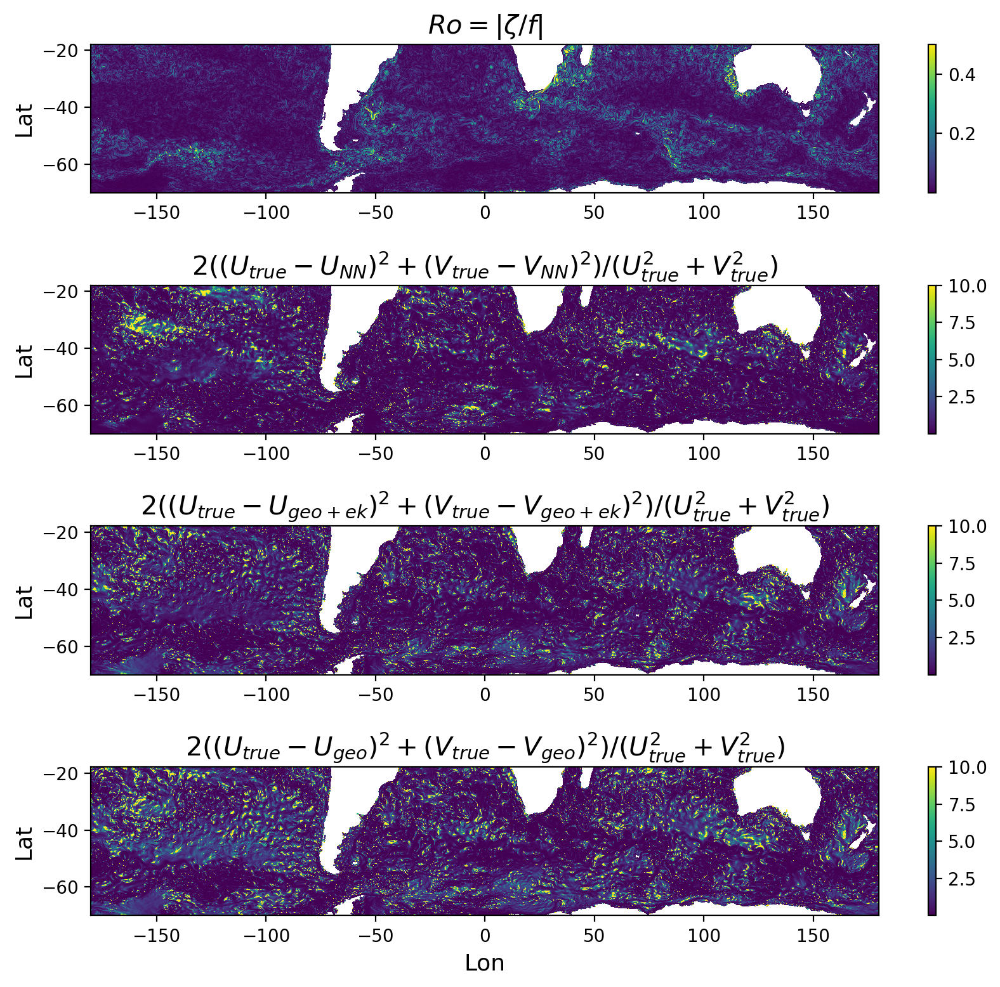

In [271]:
fig = plt.figure(figsize=(8,8),dpi=200)

plt.subplot(411)
plt.pcolormesh(x,y,vels['abs_Ro_m'], vmax=0.5, cmap='viridis', rasterized=True);
plt.title(r'$Ro =\| \zeta/f \| $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(412)
plt.pcolormesh(x,y,vels['re_n'], vmax=10, cmap='viridis', rasterized=True);
plt.title(r'$ 2((U_{true} - U_{NN})^2 +(V_{true} - V_{NN})^2)/(U_{true}^2 + V_{true}^2) $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(413)
plt.pcolormesh(x,y,vels['re_ge'], vmax=10, cmap='viridis', rasterized=True);
plt.title(r'$2((U_{true} - U_{geo+ek})^2 + (V_{true} - V_{geo+ek})^2)/(U_{true}^2 + V_{true}^2) $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(414)
plt.pcolormesh(x,y,vels['re_g'], vmax=10, cmap='viridis', rasterized=True);
plt.title(r'$2((U_{true} - U_{geo})^2 + (V_{true} - V_{geo})^2)/(U_{true}^2 + V_{true}^2) $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])

fig.savefig(figdir+'Ro_rE_UV_SO.png')
fig.savefig(figdir+'Ro_rE_UV_SO.pdf',dpi=200)
fig.savefig(figdir+'Ro_rE_UV_SO_150dpi.pdf',dpi=150)


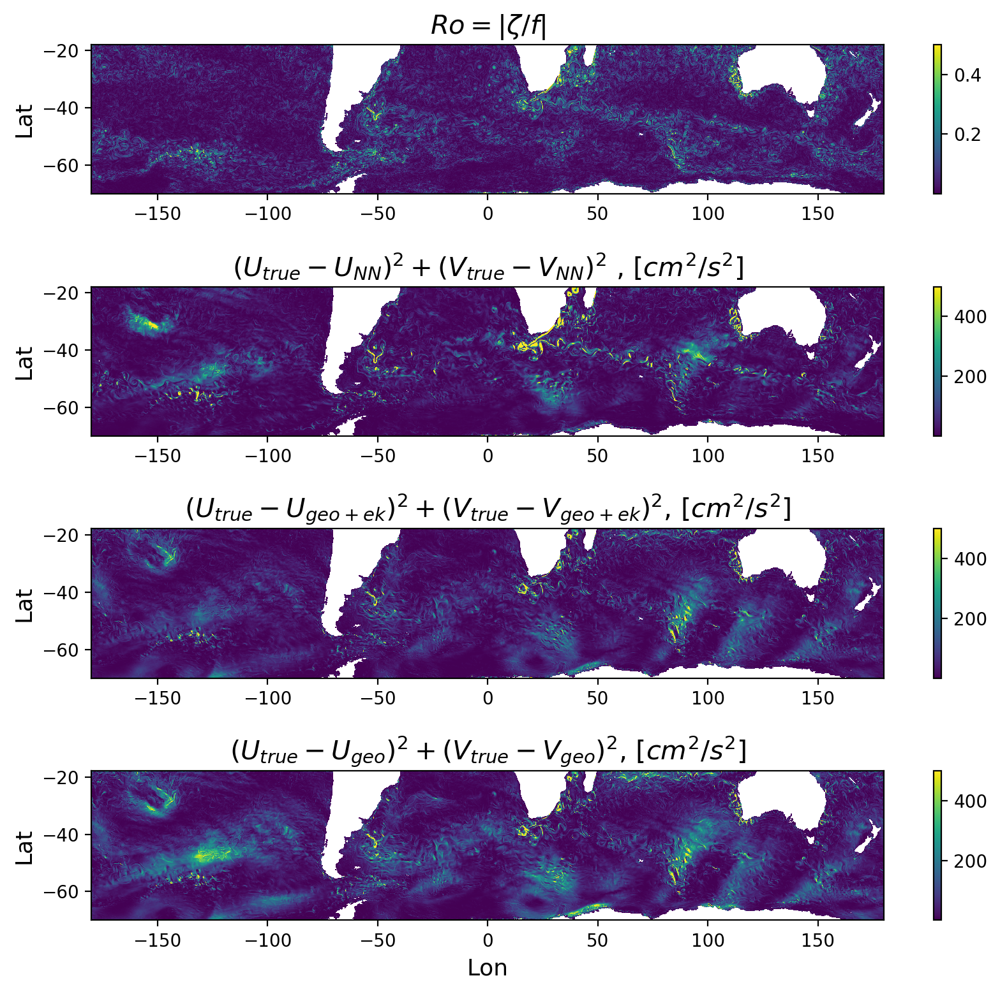

In [277]:
fig = plt.figure(figsize=(8,8),dpi=200)

plt.subplot(411)
plt.pcolormesh(x,y,vels['abs_Ro_m'], vmax=0.5, cmap='viridis', rasterized=True);
plt.title(r'$Ro =\| \zeta/f \| $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(412)
plt.pcolormesh(x,y,vels['se_n_m'], vmax=500, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{NN})^2 +(V_{true} - V_{NN})^2 $ , $[cm^2/s^2]$', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(413)
plt.pcolormesh(x,y,vels['se_ge_m'], vmax=500, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo+ek})^2 + (V_{true} - V_{geo+ek})^2 $, $[cm^2/s^2]$', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(414)
plt.pcolormesh(x,y,vels['se_g_m'], vmax=500, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo})^2 + (V_{true} - V_{geo})^2 $, $[cm^2/s^2]$', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])

fig.savefig(figdir+'Ro_SE_UV_SO.png')
fig.savefig(figdir+'Ro_SE_UV_SO.pdf',dpi=200)
fig.savefig(figdir+'Ro_SE_UV_SO_150dpi.pdf',dpi=150)


In [ ]:
corrs = {}
corrs['se_n'] = np.ma.MaskedArray.flatten(vels['se_n_m'])
#corrs['se_g'] = vels['se_g_m'].ravel()
#corrs['se_ge'] = vels['se_ge_m'].ravel()
corrs['Ro'] = np.ma.MaskedArray.flatten(vels['abs_Ro_m'])

In [166]:
vels['se_n_m'].shape

(800, 3600)

In [167]:
vels['abs_Ro_m'].T.shape

(3600, 800)

In [169]:
np.corrcoef(vels['se_n_m'].compressed(),vels['abs_Ro_m'].compressed())

array([[1.        , 0.18421465],
       [0.18421465, 1.        ]])

In [217]:
corrs= {}
corrs['Cov'] = np.nansum((vels['se_n_m']- np.nanmean(vels['se_n_m']))*(vels['abs_Ro_m'] - np.nanmean(vels['abs_Ro_m'])))
corrs['var_se_N'] = np.nansum((vels['se_n_m']- np.nanmean(vels['se_n_m']))**2)
corrs['var_Ro'] = np.nansum((vels['abs_Ro_m']- np.nanmean(vels['abs_Ro_m']))**2)


In [218]:
corrs['Corr_N'] = corrs['Cov']/(np.sqrt(corrs['var_se_N']*corrs['var_Ro']))

In [219]:
corrs

{'Corr_N': 0.19763213907114358,
 'Cov': 789142.1118083581,
 'var_Ro': 1024.9801095178539,
 'var_se_N': 15555353000.0}

Text(0, 0.5, 'Lat')

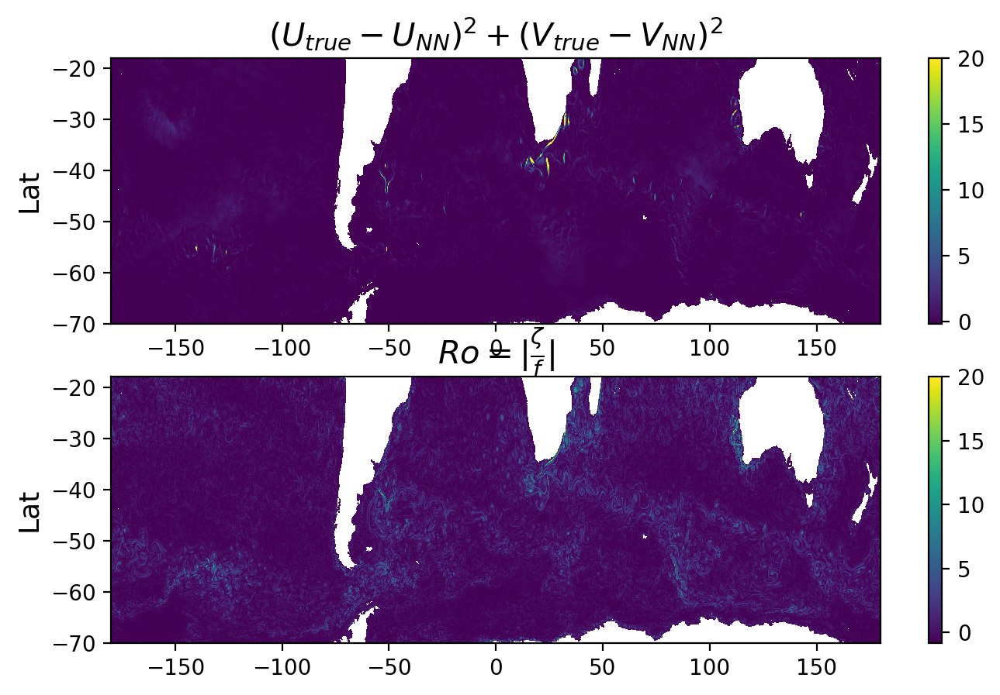

In [183]:
vels['se_n_m_N'] = (vels['se_n_m'] - np.nanmean(vels['se_n_m']))/(np.nanstd(vels['se_n_m']))
vels['abs_Ro_m_N'] = (vels['abs_Ro_m'] - np.nanmean(vels['abs_Ro_m']))/(np.nanstd(vels['abs_Ro_m']))

fig = plt.figure(figsize=(8,5),dpi=200)

plt.subplot(211)
plt.pcolormesh(x,y,vels['se_n_m_N'],vmax=20,cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{NN})^2 +(V_{true} - V_{NN})^2 $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(212)
plt.pcolormesh(x,y,vels['abs_Ro_m_N'], vmax=20, cmap='viridis', rasterized=True);
plt.title(r'$Ro =\| \frac{\zeta}{f} \| $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')


In [245]:
from matplotlib.colors import LogNorm


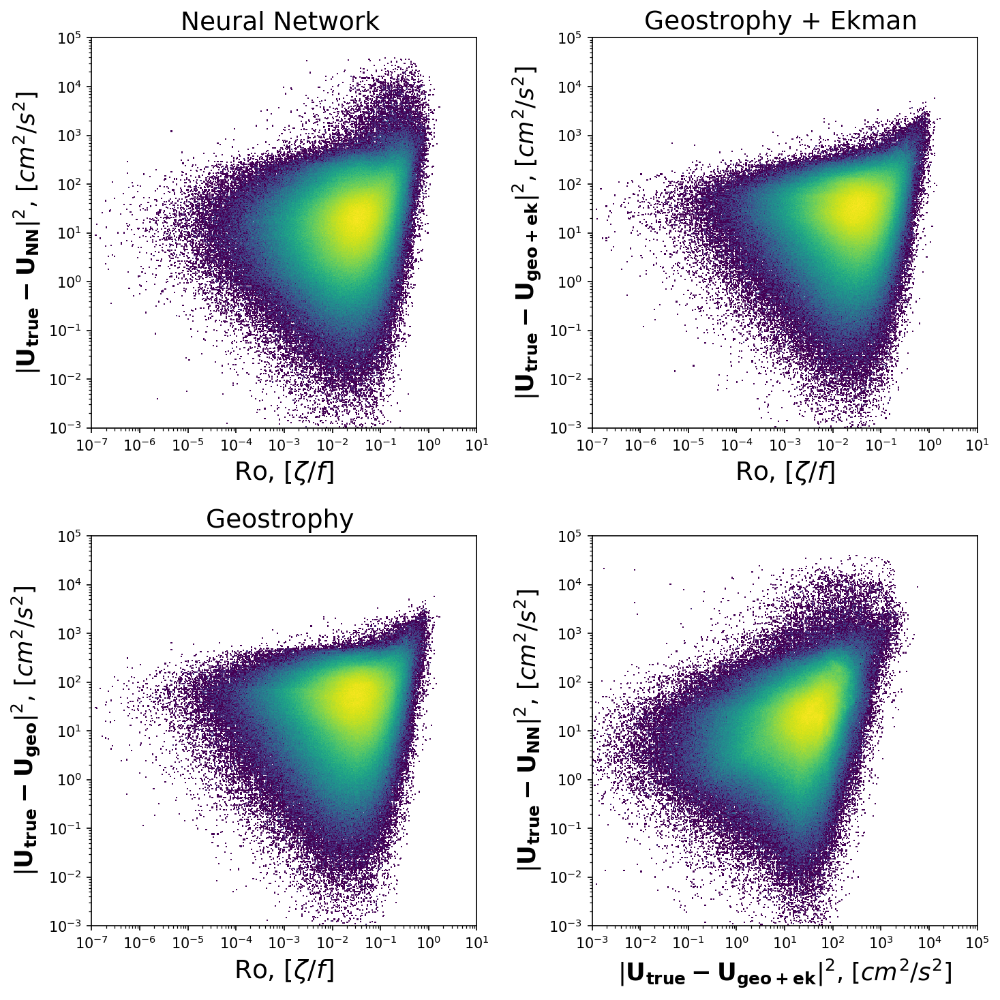

In [281]:
corrs= {}
corrs['se_n'] = ((vels['se_n_m'])).compressed()
corrs['se_ge'] = ((vels['se_ge_m'])).compressed()
corrs['se_g'] = ((vels['se_g_m'])).compressed()
#corrs['se_g'] = vels['se_g_m'].ravel()
#corrs['se_ge'] = vels['se_ge_m'].ravel()
corrs['Ro'] = ((vels['abs_Ro_m'])).compressed()

x_space = np.logspace(np.log10(10**-7), np.log10(10), 500)
#print('x_space:', x_space)

y_space = np.logspace(np.log10(10**-3), np.log10(10**5), 500)
#print('y_space:', y_space)

fig = plt.figure(figsize=(10,10), dpi=150)
plt.subplot(221)
plt.hist2d(corrs['Ro'],corrs['se_n'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm(), rasterized=True);
plt.yscale('log')
plt.xscale('log')
plt.xlabel(r'Ro, [$\zeta/f$]', fontsize=18)
#plt.ylabel(r'Squared Error, velocities, $[cm^2/s^2]$', fontsize=17)
plt.ylabel(r'$\|\mathbf{U_{true} - U_{NN}}\|^2$, $[cm^2/s^2]$', fontsize=17)

plt.title('Neural Network ', fontsize=18)



plt.subplot(222)
plt.hist2d(corrs['Ro'],corrs['se_ge'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm(), rasterized=True);
plt.yscale('log')
plt.xscale('log')
plt.xlabel(r'Ro, [$\zeta/f$]', fontsize=18)
plt.ylabel(r'$\|\mathbf{U_{true} - U_{geo+ek}}\|^2$, $[cm^2/s^2]$', fontsize=17)
plt.title('Geostrophy + Ekman ', fontsize=18)



plt.subplot(223)
plt.hist2d(corrs['Ro'],corrs['se_g'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm(), rasterized=True);
plt.yscale('log')
plt.xscale('log')
plt.xlabel(r'Ro, [$\zeta/f$]', fontsize=18)
plt.ylabel(r'$\|\mathbf{U_{true} - U_{geo}}\|^2$, $[cm^2/s^2]$', fontsize=17)
plt.title('Geostrophy ', fontsize=18)


plt.subplot(224)
plt.hist2d(corrs['se_ge'],corrs['se_n'], bins=(y_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm(), rasterized=True);
plt.yscale('log')
plt.xscale('log')
plt.xlabel(r'$\|\mathbf{U_{true} - U_{geo+ek}}\|^2$, $[cm^2/s^2]$', fontsize=17)
plt.ylabel(r'$\|\mathbf{U_{true} - U_{NN}}\|^2$, $[cm^2/s^2]$', fontsize=17)


plt.tight_layout()

fig.savefig(figdir+'Scatterplot_errors.pdf', dpi=150)

#plt.xlim([-0.02,1.5])

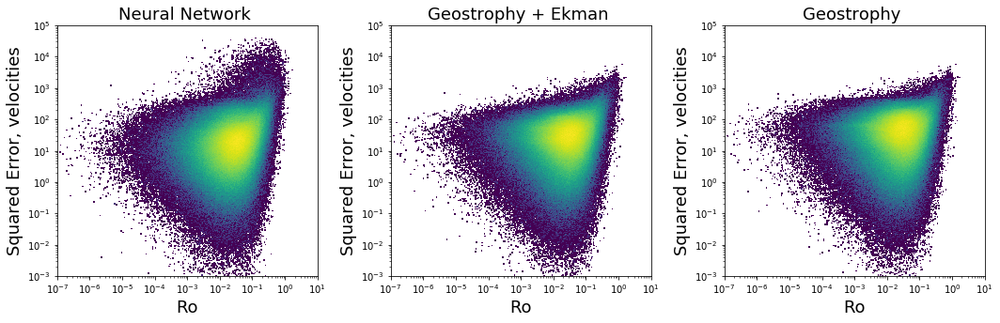

In [260]:
corrs= {}
corrs['se_n'] = ((vels['se_n_m'])).compressed()
corrs['se_ge'] = ((vels['se_ge_m'])).compressed()
corrs['se_g'] = ((vels['se_g_m'])).compressed()
#corrs['se_g'] = vels['se_g_m'].ravel()
#corrs['se_ge'] = vels['se_ge_m'].ravel()
corrs['Ro'] = ((vels['abs_Ro_m'])).compressed()

x_space = np.logspace(np.log10(10**-7), np.log10(10), 500)
#print('x_space:', x_space)

y_space = np.logspace(np.log10(10**-3), np.log10(10**5), 500)
#print('y_space:', y_space)

plt.figure(figsize=(15,5))
plt.subplot(131)
plt.hist2d(corrs['Ro'],corrs['se_n'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Squared Error, velocities', fontsize=18)
plt.title('Neural Network ', fontsize=18)



plt.subplot(132)
plt.hist2d(corrs['Ro'],corrs['se_ge'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Squared Error, velocities', fontsize=18)
plt.title('Geostrophy + Ekman ', fontsize=18)



plt.subplot(133)
plt.hist2d(corrs['Ro'],corrs['se_g'], bins=(x_space, y_space), range= [[-0.01, 0.5], [-10, 300]], norm=LogNorm());
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Ro', fontsize=18)
plt.ylabel('Squared Error, velocities', fontsize=18)
plt.title('Geostrophy ', fontsize=18)

plt.tight_layout()

#plt.xlim([-0.02,1.5])

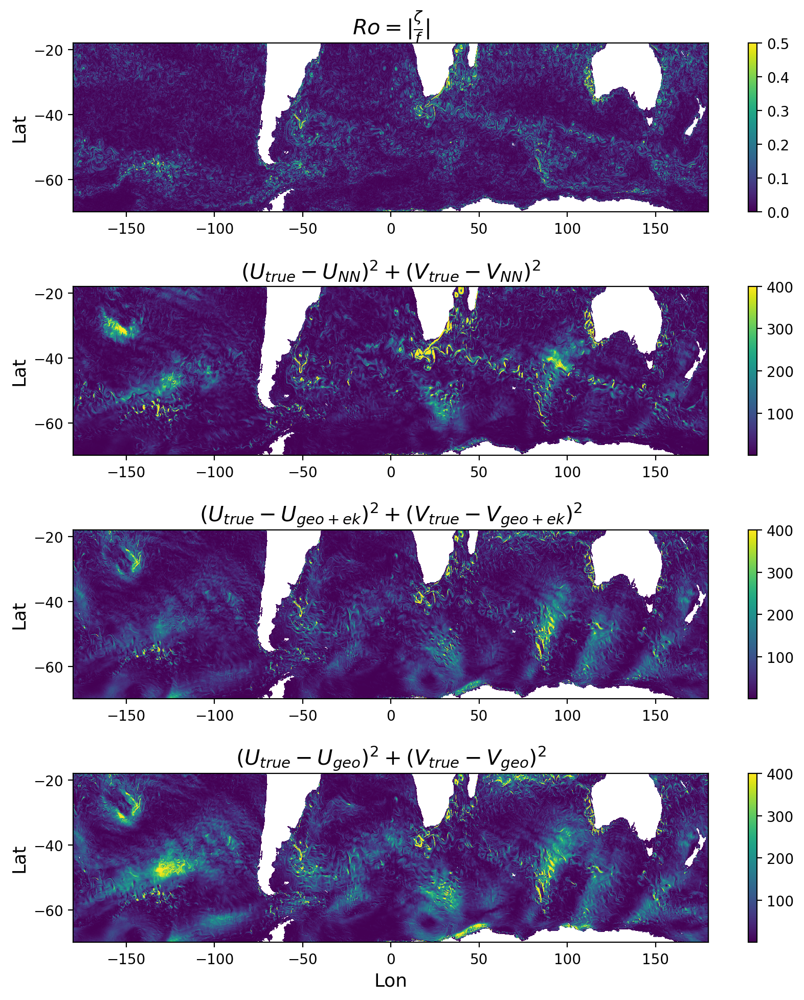

In [95]:
fig = plt.figure(figsize=(8,10),dpi=200)

plt.subplot(411)
plt.pcolormesh(x,y,vels['abs_Ro'], vmax=0.5, cmap='viridis', rasterized=True);
plt.title(r'$Ro =\| \frac{\zeta}{f} \| $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(412)
plt.pcolormesh(x,y,vels['se_n'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{NN})^2 +(V_{true} - V_{NN})^2 $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(413)
plt.pcolormesh(x,y,vels['se_ge'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo+ek})^2 + (V_{true} - V_{geo+ek})^2 $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(414)
plt.pcolormesh(x,y,vels['se_g'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo})^2 + (V_{true} - V_{geo})^2 $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])


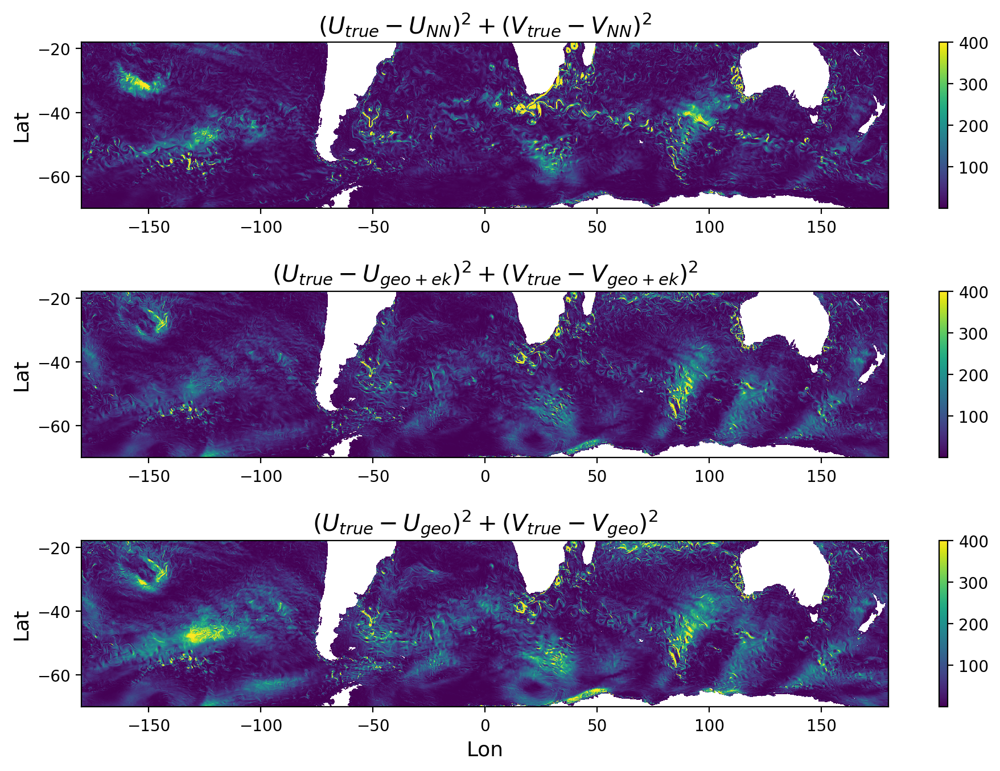

In [89]:
fig = plt.figure(figsize=(9,7),dpi=200)

plt.subplot(311)
plt.pcolormesh(x,y,vels['se_n'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{NN})^2 +(V_{true} - V_{NN})^2 $', fontsize=15)

#plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(312)
plt.pcolormesh(x,y,vels['se_ge'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo+ek})^2 + (V_{true} - V_{geo+ek})^2 $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(313)
plt.pcolormesh(x,y,vels['se_g'], vmax=400, cmap='viridis', rasterized=True);
plt.title(r'$(U_{true} - U_{geo})^2 + (V_{true} - V_{geo})^2 $', fontsize=15)
#plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
#          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])


In [ ]:
# You want to calculate Rossby Number as vort/f
# where vort = dv/dx - du/dy

In [83]:
vels['u_t']

array([[ -9.483089  ,  -9.046331  ,  -8.773409  , ..., -11.515953  ,
        -10.768138  , -10.0708    ],
       [-10.316279  ,  -9.572249  ,  -9.01218   , ..., -13.023516  ,
        -12.118863  , -11.188871  ],
       [-11.598715  , -10.583931  ,  -9.708007  , ..., -14.514226  ,
        -13.672766  , -12.663584  ],
       ...,
       [ -8.334127  ,  -5.687755  ,  -4.1244707 , ..., -15.405125  ,
        -13.797164  , -11.259847  ],
       [ -6.305025  ,  -2.5672822 ,  -0.08656662, ..., -15.039819  ,
        -12.980883  ,  -9.691398  ],
       [ -7.0298734 ,  -2.0679386 ,   2.7861576 , ..., -14.744265  ,
        -13.320752  , -10.483789  ]], dtype=float32)

In [77]:
errs = {}
errs['mae_u_n'] = np.nanmean((np.abs(vels['u_n']-vels['u_t'])))
errs['mae_v_n'] = np.nanmean((np.abs(vels['v_n']-vels['v_t'])))
errs['rmse_u_n'] = np.sqrt(np.nanmean((vels['u_n']-vels['u_t'])**2))
errs['rmse_v_n'] = np.sqrt(np.nanmean((vels['v_n']-vels['v_t'])**2))

errs['bias_u_n'] = np.nanmean(vels['u_n']) - np.nanmean(vels['u_t'])
errs['bias_v_n'] = np.nanmean(vels['v_n']) - np.nanmean(vels['v_t'])


errs['mae_u_ge'] = np.nanmean((np.abs(vels['u_ge']-vels['u_t'])))
errs['mae_v_ge'] = np.nanmean((np.abs(vels['v_ge']-vels['v_t'])))
errs['rmse_u_ge'] = np.sqrt(np.nanmean((vels['u_ge']-vels['u_t'])**2))
errs['rmse_v_ge'] = np.sqrt(np.nanmean((vels['v_ge']-vels['v_t'])**2))

errs['bias_u_ge'] = np.nanmean(vels['u_ge']) - np.nanmean(vels['u_t'])
errs['bias_v_ge'] = np.nanmean(vels['v_ge']) - np.nanmean(vels['v_t'])


errs['mae_u_g'] = np.nanmean((np.abs(vels['u_g']-vels['u_t'])))
errs['mae_v_g'] = np.nanmean((np.abs(vels['v_g']-vels['v_t'])))
errs['rmse_u_g'] = np.sqrt(np.nanmean((vels['u_g']-vels['u_t'])**2))
errs['rmse_v_g'] = np.sqrt(np.nanmean((vels['v_g']-vels['v_t'])**2))

errs['bias_u_g'] = np.nanmean(vels['u_g']) - np.nanmean(vels['u_t'])
errs['bias_v_g'] = np.nanmean(vels['v_g']) - np.nanmean(vels['v_t'])

errs['theta_n'] =np.nanmean((np.arccos((vels['u_n']*vels['u_t'] + vels['v_n']*vels['v_t'])/
                            (np.sqrt(vels['u_n']**2+vels['v_n']**2)*np.sqrt(vels['u_t']**2+vels['v_t']**2)))))

errs['theta_ge'] =np.nanmean((np.arccos((vels['u_ge']*vels['u_t'] + vels['v_ge']*vels['v_t'])/
                            (np.sqrt(vels['u_ge']**2+vels['v_ge']**2)*np.sqrt(vels['u_t']**2+vels['v_t']**2)))))

errs['theta_g'] =np.nanmean((np.arccos((vels['u_g']*vels['u_t'] + vels['v_g']*vels['v_t'])/
                            (np.sqrt(vels['u_g']**2+vels['v_g']**2)*np.sqrt(vels['u_t']**2+vels['v_t']**2)))))


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/ipykernel/__main__.py:29: RuntimeWarning: invalid value encountered in arccos
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/ipykernel/__main__.py:32: RuntimeWarning: invalid value encountered in arccos
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/ipykernel/__main__.py:35: RuntimeWarning: invalid value encountered in arccos


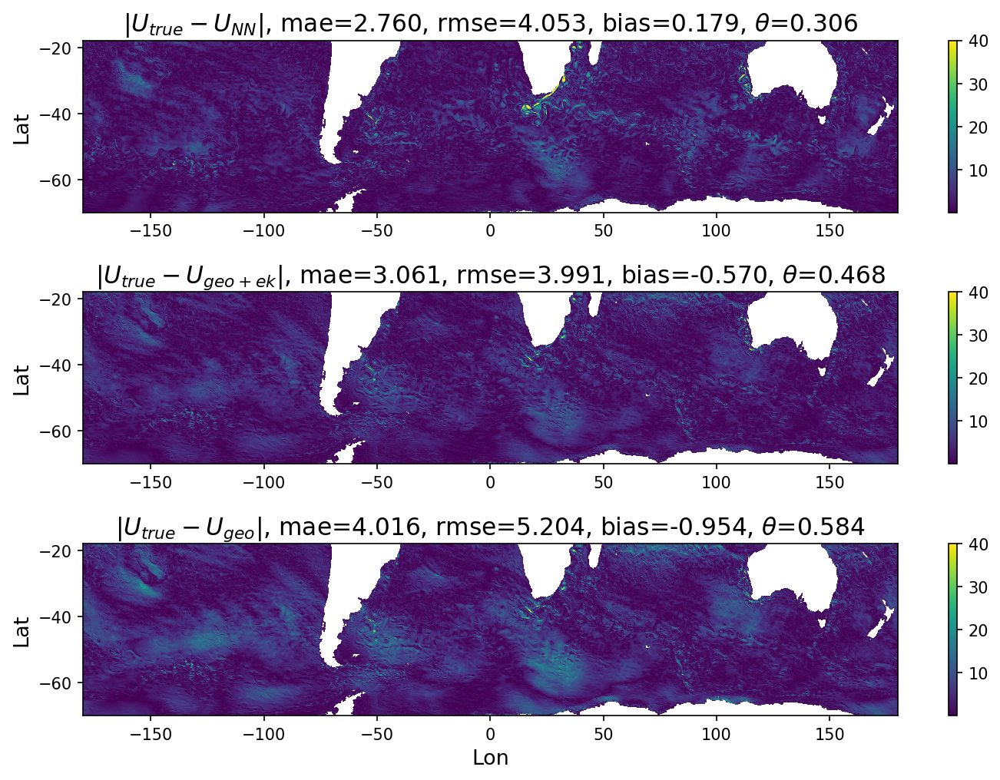

In [80]:
fig = plt.figure(figsize=(9,7),dpi=150)

plt.subplot(311)
plt.pcolormesh(x,y,vels['ae_u_n'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(312)
plt.pcolormesh(x,y,vels['ae_u_ge'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(313)
plt.pcolormesh(x,y,vels['ae_u_g'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])
fig.savefig(figdir+'AE_U_SO.png')
fig.savefig(figdir+'AE_U_SO.pdf',dpi=200)
fig.savefig(figdir+'AE_U_SO_150dpi.pdf',dpi=150)


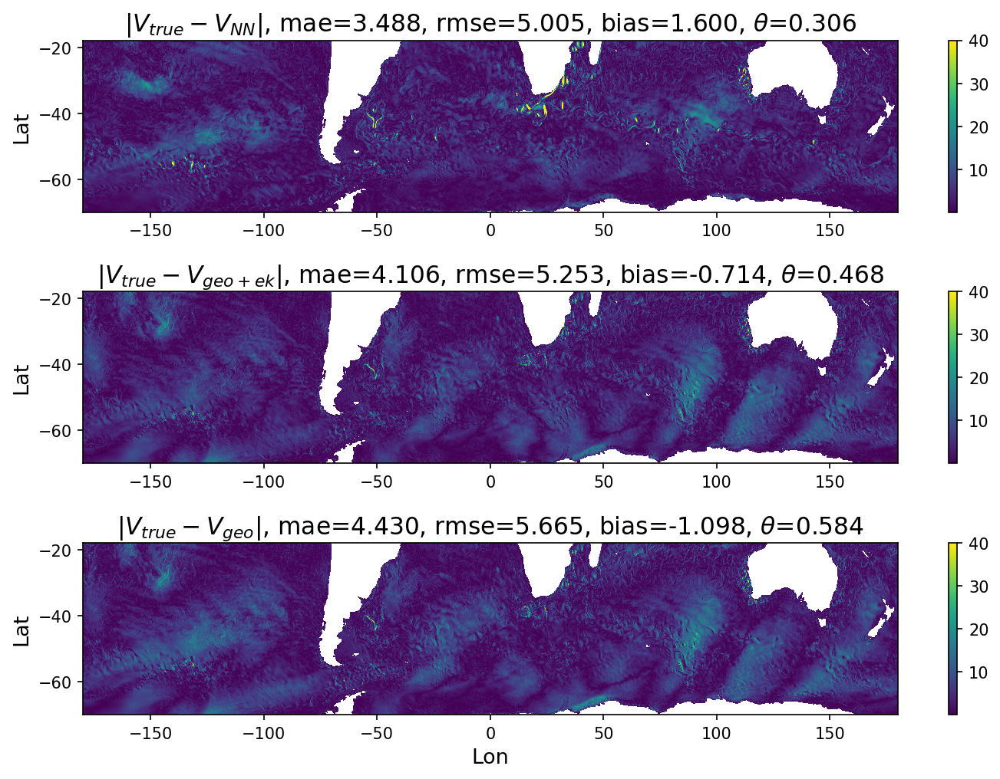

In [81]:
fig = plt.figure(figsize=(9,7),dpi=150)

plt.subplot(311)
plt.pcolormesh(x,y,vels['ae_v_n'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_n'],errs['rmse_v_n'],errs['bias_v_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(312)
plt.pcolormesh(x,y,vels['ae_v_ge'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_ge'],errs['rmse_v_ge'],errs['bias_v_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(313)
plt.pcolormesh(x,y,vels['ae_v_g'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_g'],errs['rmse_v_g'],errs['bias_v_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])
fig.savefig(figdir+'AE_V_SO.png')
fig.savefig(figdir+'AE_V_SO.pdf',dpi=200)
fig.savefig(figdir+'AE_V_SO_150dpi.pdf',dpi=150)


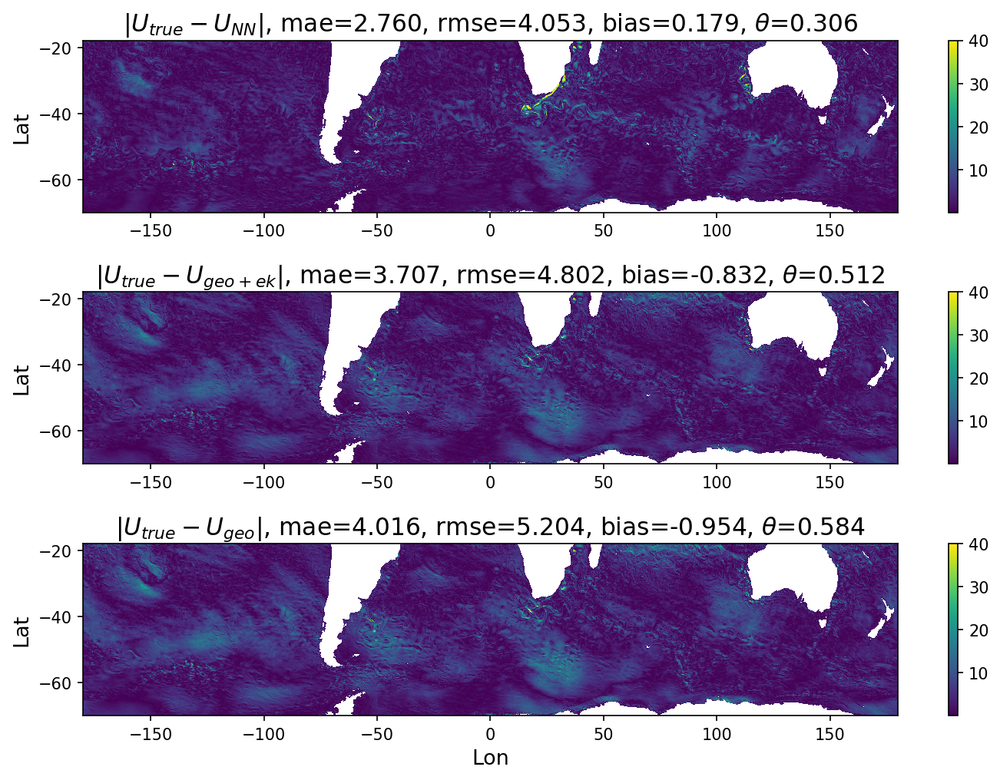

In [74]:
fig = plt.figure(figsize=(9,7),dpi=150)

plt.subplot(311)
plt.pcolormesh(x,y,vels['ae_u_n'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(312)
plt.pcolormesh(x,y,vels['ae_u_ge'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(313)
plt.pcolormesh(x,y,vels['ae_u_g'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])
fig.savefig(figdir+'AE_U_SO.png')
fig.savefig(figdir+'AE_U_SO.pdf',dpi=200)
fig.savefig(figdir+'AE_U_SO_150dpi.pdf',dpi=150)


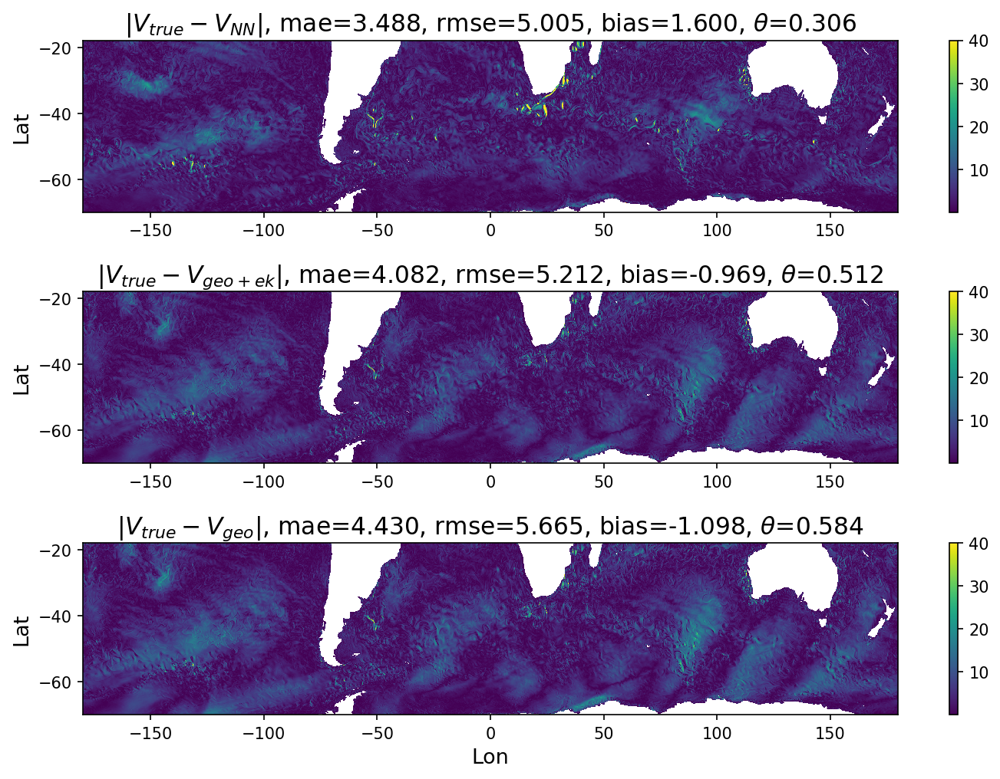

In [75]:
fig = plt.figure(figsize=(9,7),dpi=150)

plt.subplot(311)
plt.pcolormesh(x,y,vels['ae_v_n'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{NN}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_n'],errs['rmse_v_n'],errs['bias_v_n'], errs['theta_n']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.subplot(312)
plt.pcolormesh(x,y,vels['ae_v_ge'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{geo+ek}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_ge'],errs['rmse_v_ge'],errs['bias_v_ge'], errs['theta_ge']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')

plt.subplot(313)
plt.pcolormesh(x,y,vels['ae_v_g'], vmax=40, cmap='viridis', rasterized=True);
plt.title(r'$\|V_{true} - V_{geo}\|$, mae=%1.3f, rmse=%1.3f, bias=%1.3f, $\theta$=%1.3f'  
          %(errs['mae_v_g'],errs['rmse_v_g'],errs['bias_v_g'], errs['theta_g']), fontsize=15)
plt.colorbar()
plt.ylabel('Lat')
plt.xlabel('Lon')

plt.tight_layout(rect=[0,0,1.1,1])
fig.savefig(figdir+'AE_V_SO.png')
fig.savefig(figdir+'AE_V_SO.pdf',dpi=200)
fig.savefig(figdir+'AE_V_SO_150dpi.pdf',dpi=150)


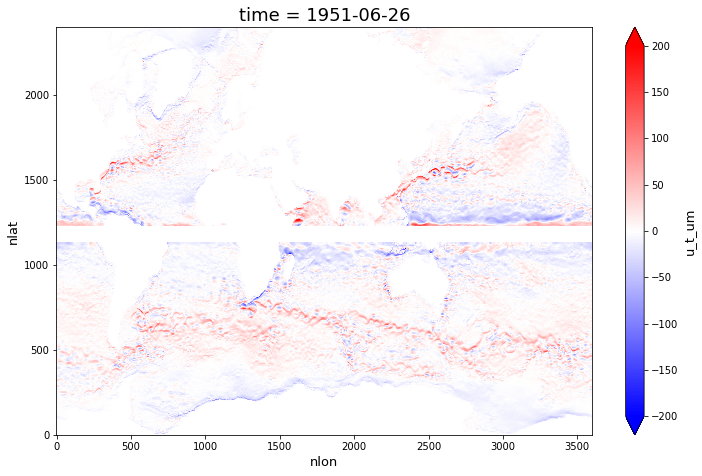

In [18]:
ds_snap.u_t_um.plot(vmin=-200,vmax=200,cmap='bwr')

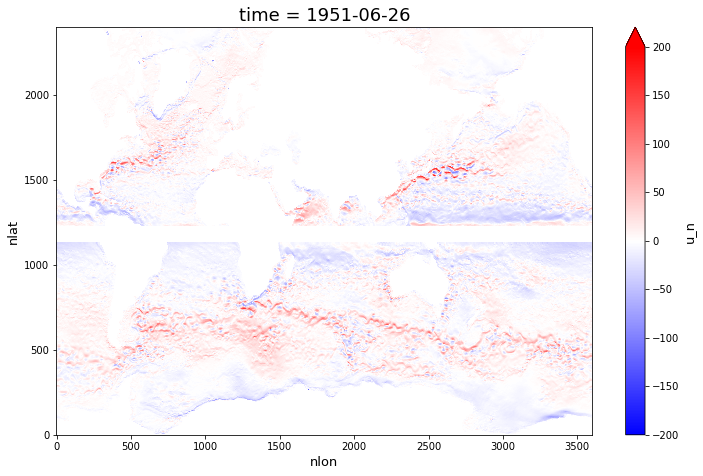

In [14]:
ds_snap.u_n.plot(vmin=-200,vmax=200,cmap='bwr')

In [ ]:
ds_snap.v_n_um.plot()